In [ ]:
!pip install -U fortran-magic

%matplotlib inline
%load_ext fortranmagic

import sys; sys.path.append('..')

import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

mpl.rc('figure', figsize=(12, 7))

ran_the_first_cell = True

jan2017 = pd.to_datetime(['2017-01-03 00:00:00+00:00',
 '2017-01-04 00:00:00+00:00',
 '2017-01-05 00:00:00+00:00',
 '2017-01-06 00:00:00+00:00',
 '2017-01-09 00:00:00+00:00',
 '2017-01-10 00:00:00+00:00',
 '2017-01-11 00:00:00+00:00',
 '2017-01-12 00:00:00+00:00',
 '2017-01-13 00:00:00+00:00',
 '2017-01-17 00:00:00+00:00',
 '2017-01-18 00:00:00+00:00',
 '2017-01-19 00:00:00+00:00',
 '2017-01-20 00:00:00+00:00',
 '2017-01-23 00:00:00+00:00',
 '2017-01-24 00:00:00+00:00',
 '2017-01-25 00:00:00+00:00',
 '2017-01-26 00:00:00+00:00',
 '2017-01-27 00:00:00+00:00',
 '2017-01-30 00:00:00+00:00',
 '2017-01-31 00:00:00+00:00',
 '2017-02-01 00:00:00+00:00'])
calendar = jan2017.values.astype('datetime64[D]')

event_dates = pd.to_datetime(['2017-01-06 00:00:00+00:00', 
                             '2017-01-07 00:00:00+00:00', 
                             '2017-01-08 00:00:00+00:00']).values.astype('datetime64[D]')
event_values = np.array([10, 15, 20])

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
The fortranmagic extension is already loaded. To reload it, use:
  %reload_ext fortranmagic


In [ ]:
%reload_ext fortranmagic

/usr/local/lib/python3.8/dist-packages/fortranmagic.py:147: UserWarning: get_ipython_cache_dir has moved to the IPython.paths module since IPython 4.0.
  self._lib_dir = os.path.join(get_ipython_cache_dir(), 'fortran')


<center>
  <h1>The PyData Toolbox</h1>
  <h3>Scott Sanderson (Twitter: @scottbsanderson, GitHub: ssanderson)</h3>
  <h3><a href="https://github.com/ssanderson/pydata-toolbox">https://github.com/ssanderson/pydata-toolbox</a></h3>
</center>

# About Me:

<img src="https://raw.githubusercontent.com/ssanderson/pydata-toolbox/master/notebooks/images/me.jpg" alt="Drawing" style="width: 300px;"/>

- Senior Engineer at [Quantopian](www.quantopian.com)
- Background in Mathematics and Philosophy
- **Twitter:** [@scottbsanderson](https://twitter.com/scottbsanderson)
- **GitHub:** [ssanderson](github.com/ssanderson)

## Outline

- Built-in Data Structures
- Numpy `array`
- Pandas `Series`/`DataFrame`
- Plotting and "Real-World" Analyses

# Data Structures

> Rule 5. Data dominates. If you've chosen the right data structures and organized things well, the algorithms
will almost always be self-evident. Data structures, not algorithms, are central to programming.

- *Notes on Programming in C*, by Rob Pike.

# Lists

In [ ]:
assert ran_the_first_cell, "Oh noes!"

In [ ]:
l = [1, 'two', 3.0, 4, 5.0, "six"]
l

[1, 'two', 3.0, 4, 5.0, 'six']

In [ ]:
# Lists can be indexed like C-style arrays.
first = l[0]
second = l[1]
print("first:", first)
print("second:", second)

first: 1
second: two


**My own example 1**

In [ ]:
m = [1,2,3.0,'four']
m
first = m[2]
second = m[3]
print("tercero:", first)
print("cuarto:", second)

tercero: 3.0
cuarto: four


In [ ]:
# Negative indexing gives elements relative to the end of the list.
last = l[-1]
penultimate = l[-2]
print("last:", last)
print("second to last:", penultimate)

last: six
second to last: 5.0


In [ ]:
# Lists can also be sliced, which makes a copy of elements between 
# start (inclusive) and stop (exclusive)
sublist = l[1:3]
sublist

['two', 3.0]

In [ ]:
# l[:N] is equivalent to l[0:N].
first_three = l[:3]
first_three

[1, 'two', 3.0]

**My own example 2**

In [ ]:
ult = m[-1]
penult = m[-2]
print("last:", ult)
print("second to last:", penult)
sublist = m[0:2]
print(sublist)
first_three = m[:2]
print('primeros dos: ',first_three)

last: four
second to last: 3.0
[1, 2]
primeros dos:  [1, 2]


In [ ]:
# l[3:] is equivalent to l[3:len(l)].
after_three = l[3:]
after_three

[4, 5.0, 'six']

In [ ]:
# There's also a third parameter, "step", which gets every Nth element.
l = ['a', 'b', 'c', 'd', 'e', 'f', 'g','h']
l[1:7:2]

['b', 'd', 'f']

In [ ]:
# This is a cute way to reverse a list.
l[::-1]

['h', 'g', 'f', 'e', 'd', 'c', 'b', 'a']

**My own example 3**

In [ ]:
#
after_three = m[2:]
print('despues del segundo: ',after_three)
#
m = ['i', 'j', 'k', 'l', 'm', 'n', 'o','p']
print(m[1:7:2])
#
print(m[::-1])

despues de dos:  ['k', 'l', 'm', 'n', 'o', 'p']
['j', 'l', 'n']
['p', 'o', 'n', 'm', 'l', 'k', 'j', 'i']


In [ ]:
# Lists can be grown efficiently (in O(1) amortized time).
l = [1, 2, 3, 4, 5]
print("Before:", l)
l.append('six')
print("After:", l)

Before: [1, 2, 3, 4, 5]
After: [1, 2, 3, 4, 5, 'six']


In [ ]:
# Comprehensions let us perform elementwise computations.
l = [1, 2, 3, 4, 5]
[x * 2 for x in l]

[2, 4, 6, 8, 10]

**My own example 4**

In [ ]:
#
print("Before:", m)
m.append('q')
print("After:", m)
#
q = [1, 2, 3, 4, 5]
[x ** 2 for x in q]

Before: ['i', 'j', 'k', 'l', 'm', 'n', 'o', 'p']
After: ['i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q']


[1, 4, 9, 16, 25]

## Review: Python Lists

- Zero-indexed sequence of arbitrary Python values.
- Slicing syntax: `l[start:stop:step]` copies elements at regular intervals from `start` to `stop`.
- Efficient (`O(1)`) appends and removes from end.
- Comprehension syntax: `[f(x) for x in l if cond(x)]`.

# Dictionaries

In [ ]:
# Dictionaries are key-value mappings.
philosophers = {'David': 'Hume', 'Immanuel': 'Kant', 'Bertrand': 'Russell'}
philosophers

{'David': 'Hume', 'Immanuel': 'Kant', 'Bertrand': 'Russell'}

In [ ]:
# Like lists, dictionaries are size-mutable.
philosophers['Ludwig'] = 'Wittgenstein'
philosophers

{'David': 'Hume',
 'Immanuel': 'Kant',
 'Bertrand': 'Russell',
 'Ludwig': 'Wittgenstein'}

In [ ]:
del philosophers['David']
philosophers

{'Immanuel': 'Kant', 'Bertrand': 'Russell', 'Ludwig': 'Wittgenstein'}

**My own example 5**

In [ ]:
dicc = {'Food': 'Burger', 'Drink': 'Soda', 'Dessert': 'Ice-cream'}
dicc['seasoning'] = 'salt'
print(dicc)
del dicc['Food']
print(dicc)

{'Food': 'Burger', 'Drink': 'Soda', 'Dessert': 'Ice-cream', 'seasoning': 'salt'}
{'Drink': 'Soda', 'Dessert': 'Ice-cream', 'seasoning': 'salt'}


In [ ]:
# No slicing.
philosophers['Bertrand':'Immanuel']

TypeError: unhashable type: 'slice'

## Review: Python Dictionaries

- Unordered key-value mapping from (almost) arbitrary keys to arbitrary values.
- Efficient (`O(1)`) lookup, insertion, and deletion.
- No slicing (would require a notion of order).

<center><img src="https://raw.githubusercontent.com/ssanderson/pydata-toolbox/master/notebooks/images/pacino.gif" alt="Drawing" style="width: 100%;"/></center>


In [ ]:
# Suppose we have some matrices...
a = [[1, 2, 3],
     [2, 3, 4],
     [5, 6, 7],
     [1, 1, 1]]

b = [[1, 2, 3, 4],
     [2, 3, 4, 5]]

**My own example 6**

In [ ]:
x = [[10,20],
     [15,25],
     [20,30],
     [25,35]]
     
y = [[1,2,3,4],
     [5,6,7,8]]

In [ ]:
def matmul(A, B):
    """Multiply matrix A by matrix B."""
    rows_out = len(A)
    cols_out = len(B[0])
    out = [[0 for col in range(cols_out)] for row in range(rows_out)]
    
    for i in range(rows_out):
        for j in range(cols_out):
            for k in range(len(B)):
                out[i][j] += A[i][k] * B[k][j]
    return out

<center><img src="https://raw.githubusercontent.com/ssanderson/pydata-toolbox/master/notebooks/images/gross.gif" alt="Drawing" style="width: 50%;"/></center>


In [ ]:
%%time

matmul(a, b)

CPU times: user 30 µs, sys: 5 µs, total: 35 µs
Wall time: 40.3 µs


[[5, 8, 11, 14], [8, 13, 18, 23], [17, 28, 39, 50], [3, 5, 7, 9]]

**My own example 0 - cpu info**

In [ ]:
!cat /proc/cpuinfo

processor	: 0
vendor_id	: AuthenticAMD
cpu family	: 23
model		: 49
model name	: AMD EPYC 7B12
stepping	: 0
microcode	: 0xffffffff
cpu MHz		: 2249.998
cache size	: 512 KB
physical id	: 0
siblings	: 2
core id		: 0
cpu cores	: 1
apicid		: 0
initial apicid	: 0
fpu		: yes
fpu_exception	: yes
cpuid level	: 13
wp		: yes
flags		: fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pge mca cmov pat pse36 clflush mmx fxsr sse sse2 ht syscall nx mmxext fxsr_opt pdpe1gb rdtscp lm constant_tsc rep_good nopl nonstop_tsc cpuid extd_apicid tsc_known_freq pni pclmulqdq ssse3 fma cx16 sse4_1 sse4_2 movbe popcnt aes xsave avx f16c rdrand hypervisor lahf_lm cmp_legacy cr8_legacy abm sse4a misalignsse 3dnowprefetch osvw topoext ssbd ibrs ibpb stibp vmmcall fsgsbase tsc_adjust bmi1 avx2 smep bmi2 rdseed adx smap clflushopt clwb sha_ni xsaveopt xsavec xgetbv1 clzero xsaveerptr arat npt nrip_save umip rdpid
bugs		: sysret_ss_attrs null_seg spectre_v1 spectre_v2 spec_store_bypass retbleed
bogomips	: 4499.99
TLB s

**My own example 1 - Changing in matmul(A, B) Python len(B) (# of rows of B) for len(A[0]) (# of columns of A)**

In [ ]:
a2 = [[1, 2, 3],
     [2, 3, 4],
     [5, 6, 7],
     [1, 1, 1]]

b2 = [[1, 2, 3, 4],
     [2, 3, 4, 5],
     [3, 4, 5, 6]]

**My own example 2 - Verifiying error with in matmul(A, B) Python with the original matrices when changing len(B) (# of rows of B) for len(A[0]) (# of colums of A)**

In [ ]:
%%time
matmul(a, b)

CPU times: user 38 µs, sys: 0 ns, total: 38 µs
Wall time: 42.4 µs


[[5, 8, 11, 14], [8, 13, 18, 23], [17, 28, 39, 50], [3, 5, 7, 9]]

**My own example 3 - Chekcing the mtarix multiplication compatibility condition  len(A[0]) == len(B)**

In [ ]:
%%time

matmul(a2, b2)

CPU times: user 38 µs, sys: 0 ns, total: 38 µs
Wall time: 42.7 µs


[[14, 20, 26, 32], [20, 29, 38, 47], [38, 56, 74, 92], [6, 9, 12, 15]]

**My own example 4 -  Verifiying error with in matmul(A, B) Python when checking the mtarix multiplication compatibility condition  len(A[0]) == len(B)**

In [ ]:
def secondmatmul(A, B):
    """Multiply matrix A by matrix B."""
    rows_out = len(A)
    cols_out = len(B[0])
    if rows_out!=cols_out: out = []
    else:
      out = [[0 for col in range(cols_out)] for row in range(rows_out)]

      for i in range(rows_out):
          for j in range(cols_out):
              for k in range(len(B)):
                  out[i][j] += A[i][k] * B[k][j]
    return out

**My own example 5 - Deifining A and B that are compatible for multiplcation**

In [ ]:
secondmatmul(a2,b2)

[[14, 20, 26, 32], [20, 29, 38, 47], [38, 56, 74, 92], [6, 9, 12, 15]]

**My own example 6 - Runinng the correct Python matrix multiplication code with the matrices with dimensions compatible for multiplication.**

In [ ]:
import random

In [ ]:
random.normalvariate(0,1)

-2.2020206175433485

In [ ]:
import random
def random_matrix(m, n):
    out = []
    for row in range(m):
        out.append([random.random() for _ in range(n)])
    return out

randm = random_matrix(2, 3)
randm

[[0.6722431152268477, 0.9092602812165084, 0.27124526263269344],
 [0.244482827087111, 0.590829087341306, 0.8869963532371158]]

**My own example 7 - Running 10 times matmul(randa, randb) with randa and randb a randon matrices of 600 x 100 and 100 x 600 and calulating the average execution time**

In [ ]:
%%time
randa= random_matrix(100,600)
randb= random_matrix(600,100)
secondmatmul(randa,randb)

CPU times: user 970 ms, sys: 7.05 ms, total: 977 ms
Wall time: 985 ms


[[151.95719080403555,
  160.04962370268206,
  145.71542598009742,
  148.7086553750851,
  154.9047500018305,
  147.44902128204436,
  149.3914427488968,
  153.16189922078019,
  145.22713262489356,
  147.72891135177085,
  149.77038995536842,
  147.30052772837553,
  148.39990462763092,
  148.68181608399829,
  152.97797631921472,
  150.97342317899123,
  152.5343720667601,
  153.31420171187577,
  157.40026243632875,
  140.82318966191025,
  150.34892106533718,
  153.51056937396717,
  155.48242602900504,
  156.24553830066534,
  147.83035881557686,
  152.48324774855976,
  147.35164563295697,
  147.21894346181523,
  147.4936645249976,
  146.48482015082013,
  148.10921649714408,
  155.95322332298954,
  149.38146093670125,
  149.30237328213204,
  146.86055026112635,
  156.04766710900978,
  154.54570983180997,
  149.3136628612618,
  150.1737960891012,
  157.86870895394324,
  150.01829619081104,
  149.5907779734561,
  156.00374066739866,
  148.92209092975244,
  153.3078501981587,
  153.9909245800030

**My own example 8 - Creating the average execution time data frame and adding Python's average execution time**

In [ ]:
python_exec = pd.DataFrame([11.29,10.01,10.09,10.14,11.05,1.7,1.45,10.76,10.88,12.22])
python_avg = float(np.mean(python_exec))
print('Data Frame: ', python_exec)
print('Python Average: ', python_avg)

Data Frame:         0
0  11.29
1  10.01
2  10.09
3  10.14
4  11.05
5   1.70
6   1.45
7  10.76
8  10.88
9  12.22
Python Average:  8.959


In [ ]:
totales = pd.DataFrame()
totales['Nombre'] = None
totales['Promedio']=None
totales['Fact. Vel.']=None
pit=pd.Series(['Python', python_avg, 0], index=totales.columns)
totales = totales.append(pit, ignore_index=True)
print(totales)

   Nombre  Promedio Fact. Vel.
0  Python     8.959          0


**My own example 9 - Running 10 times randa and randb mutiplicaction as NumPy arrays  adding NumPy's average execution time**

In [ ]:
def random_NumPy_Matrix(m, n):
    out = []
    for row in range(m):
        out.append([random.random() for _ in range(n)])
    out = np.array(out)
    return out

In [ ]:
%%time
randa = random_NumPy_Matrix(600, 100)
randb = random_NumPy_Matrix(100, 600)
secondmatmul(randa,randb)

CPU times: user 19.1 s, sys: 122 ms, total: 19.3 s
Wall time: 19.4 s


[[24.1867921367879,
  23.68051601416962,
  24.672918255905454,
  22.052071150895564,
  24.313883235132113,
  24.19100079976686,
  25.10919335562739,
  21.1609752473085,
  23.02574384295031,
  25.740976222224997,
  25.668182824138384,
  22.300056252809995,
  23.88447807317997,
  21.43347621252091,
  27.40727186927308,
  22.395052266579405,
  22.141507053234598,
  27.20045046308301,
  23.871984597915283,
  24.946805863559142,
  24.36655886785213,
  23.9682275743531,
  23.641591311165186,
  24.180019705315118,
  25.08210725329496,
  26.71633821880087,
  25.118162726249597,
  25.234449131443967,
  22.277280744634286,
  24.88025748756547,
  20.491118642641137,
  23.15987860046866,
  24.072438482417077,
  24.771707177611134,
  24.468944360123487,
  25.402125564655663,
  24.96270131804571,
  27.369854856704926,
  21.57865489190081,
  24.853822125811796,
  25.35236500521592,
  25.557944283278026,
  24.79312733169478,
  20.70653385758332,
  24.211610191247818,
  23.801369439638712,
  23.6151184

In [ ]:
python_exec = pd.DataFrame([0.0198,0.0195,0.02,0.0193,0.0199,0.0198,0.0198,0.0198,0.0198,0.019])
python_avg = float(np.mean(python_exec))
print('Data Frame: ', python_exec)
print('NumPy Average: ', python_avg)
pit=pd.Series(['NumPy', python_avg, 0], index=totales.columns)
totales = totales.append(pit, ignore_index=True)
print(totales)

Data Frame:          0
0  0.0198
1  0.0195
2  0.0200
3  0.0193
4  0.0199
5  0.0198
6  0.0198
7  0.0198
8  0.0198
9  0.0190
NumPy Average:  0.01967
   Nombre  Promedio Fact. Vel.
0  Python   8.95900          0
1   NumPy   0.01967          0


In [ ]:
# Maybe that's not that bad?  Let's try a simpler case.
def python_dot_product(xs, ys):
    return sum(x * y for x, y in zip(xs, ys))

In [ ]:
%%fortran
subroutine fortran_dot_product(xs, ys, result)
    double precision, intent(in) :: xs(:)
    double precision, intent(in) :: ys(:)
    double precision, intent(out) :: result
    
    result = sum(xs * ys)
end

In [ ]:
list_data = [float(i) for i in range(100000)]
array_data = np.array(list_data)

In [ ]:
%%time
python_dot_product(list_data, list_data)

CPU times: user 8.05 ms, sys: 0 ns, total: 8.05 ms
Wall time: 8.29 ms


333328333350000.0

In [ ]:
%%time
fortran_dot_product(array_data, array_data)

CPU times: user 144 µs, sys: 0 ns, total: 144 µs
Wall time: 153 µs


333328333350000.0

<center><img src="https://raw.githubusercontent.com/ssanderson/pydata-toolbox/master/notebooks/images/sloth.gif" alt="Drawing" style="width: 1080px;"/></center>


**My own example 10 - Deifining A (2x2)  and B (2x2)**

In [ ]:
a4 = [[1,2],[3,4]]
b4 = [[5,6],[7,8]]

**My own example 11 - Defining Fortran subroutine matmul(A,B) for 2x2 matrices**

In [ ]:
%%fortran
subroutine fortran_matmul(a, b, c)
  implicit none
  real(kind=8), intent(in) :: a(2,2), b(2,2)
  real(kind=8), intent(out) :: c(2,2)
  
  c(1,1) = a(1,1)*b(1,1) + a(1,2)*b(2,1)
  c(1,2) = a(1,1)*b(1,2) + a(1,2)*b(2,2)
  c(2,1) = a(2,1)*b(1,1) + a(2,2)*b(2,1)
  c(2,2) = a(2,1)*b(1,2) + a(2,2)*b(2,2)
end

**My own example 12 -Run Fortran subroutine matmul(A,B) with a and b 2x2 matrices**

In [ ]:
%%time
fortran_matmul(a4, b4)

CPU times: user 90 µs, sys: 0 ns, total: 90 µs
Wall time: 140 µs


array([[19., 22.],
       [43., 50.]])

**My own example 13 - Defining Fortran subroutine matmul(A,B) for 600x100 and 100x600 matrices**

In [ ]:
%%fortran
subroutine fortran_matmul_large(a, b, x, y, z, c)
    implicit none
    integer, intent(in) :: x, y, z
    double precision, intent(in) :: a(600,*)
    double precision, intent(in) :: b(100,*)
    double precision, intent(out) :: c(x,y)
    integer I,J,K,aux
    do I=1,x
      do J=1,y
        c(I,J)=0
        do K=1,z
          c(I,J) = c(I,J) + a(I,K) * b(K,J)
        end do
      end do
    end do
end

**My own example 14 -Run Fortran subroutine matmul(A,B) with 600x100 and 100x600 matrices**

In [ ]:
a = np.array(random_matrix(600,100))
b = np.array(random_matrix(100,600))

x=len(a)
y=len(b[0])
z=len(a[0])

fortran_matmul_large(a, b, x, y, z)

array([[25.59207751, 25.21420298, 24.73265237, ..., 23.08176896,
        23.5503419 , 26.07709806],
       [26.41136465, 26.97268394, 26.89243463, ..., 25.8343595 ,
        27.11460467, 27.61846154],
       [23.0215353 , 21.82478443, 22.12179049, ..., 21.9453213 ,
        22.91024124, 23.83525715],
       ...,
       [22.36268588, 24.89524283, 23.83577012, ..., 23.40675845,
        20.54365052, 23.98251885],
       [25.91880289, 27.25738699, 24.68913781, ..., 24.91302078,
        24.35910497, 25.48356723],
       [27.57954046, 27.80408068, 25.99304085, ..., 24.69467754,
        23.46115732, 28.00564111]])

**My own example 15 - Running 10 times the  Fortran subroutine matmul(A,B) with 600x100 and 100x600 matrices and adding Fortran magic average execution time to the data frame**

In [ ]:
%%time
a = np.array(random_matrix(600,100))
b = np.array(random_matrix(100,600))

x=len(a)
y=len(b[0])
z=len(a[0])

fortran_matmul_large(a, b, x, y, z)

CPU times: user 63.2 ms, sys: 957 µs, total: 64.2 ms
Wall time: 74.6 ms


array([[25.39657529, 27.47620024, 27.23303713, ..., 27.57960758,
        27.68441803, 30.4178495 ],
       [22.96030548, 22.072298  , 21.93923719, ..., 23.02950808,
        25.23529167, 26.55019356],
       [23.87929328, 26.87150283, 25.33102319, ..., 26.17529056,
        26.31985656, 29.49108925],
       ...,
       [24.12879646, 26.07685939, 25.22683485, ..., 25.91666648,
        25.02882386, 28.25315291],
       [25.21639657, 26.03822379, 24.81414539, ..., 27.07343693,
        26.57597816, 29.03482788],
       [22.06527916, 24.17466466, 22.82382909, ..., 24.38364282,
        24.34432065, 26.07407944]])

In [ ]:
exec = pd.DataFrame([0.0394,0.02,0.0199,0.00911,0.00907,0.00977,0.0198,0.0196,0.0191,0.00957])
avg = float(np.mean(exec))
print('Data Frame: ', exec)
print('Fortran Average: ', avg)
pit=pd.Series(['Fortran magic', avg, 0], index=totales.columns)
totales = totales.append(pit, ignore_index=True)
print(totales)

Data Frame:           0
0  0.03940
1  0.02000
2  0.01990
3  0.00911
4  0.00907
5  0.00977
6  0.01980
7  0.01960
8  0.01910
9  0.00957
Fortran Average:  0.017532
          Nombre  Promedio Fact. Vel.
0         Python  8.959000          0
1          NumPy  0.019670          0
2  Fortran magic  0.017532          0


**My own example 16 - Creating a  Fortran program that mutiplies 10 times A(600x100) and  B (100x600) matrices**

In [ ]:
%%fortran
subroutine fortran_matmul_massive(a, b, x, y, z, c)
    implicit none
    integer, intent(in) :: x, y, z
    double precision, intent(in) :: a(600,*)
    double precision, intent(in) :: b(100,*)
    double precision, intent(out) :: c(x,y)
    integer I,J,K,L,aux
    do L=0,10
      do I=1,x
        do J=1,y
          c(I,J)=0
          do K=1,z
            c(I,J) = c(I,J) + a(I,K) * b(K,J)
          end do
        end do
      end do
    end do
end

**My own example 17 - Running the Fortran program that mutiplies 10 times A(600x100) and  B (100x600) matrices**

In [ ]:
%%time
a = np.array(random_matrix(600,100))
b = np.array(random_matrix(100,600))

x=len(a)
y=len(b[0])
z=len(a[0])

fortran_matmul_massive(a, b, x, y, z)

CPU times: user 343 ms, sys: 3.83 ms, total: 347 ms
Wall time: 354 ms


array([[27.88556369, 27.82279933, 26.23117204, ..., 25.94257544,
        27.72294998, 26.09773435],
       [27.74526844, 27.81847508, 25.93732904, ..., 27.45888113,
        29.10178963, 26.89448327],
       [22.70035005, 23.81600247, 23.72420714, ..., 22.90236022,
        23.57278622, 22.90667684],
       ...,
       [25.49222432, 26.11624308, 25.78400452, ..., 25.51228216,
        27.03633097, 26.18139224],
       [29.46985475, 28.52696443, 25.88338515, ..., 25.92130741,
        30.2488777 , 26.836594  ],
       [28.02204297, 30.05553987, 28.69522979, ..., 27.18792216,
        30.51043114, 26.82706714]])

**My own example 18 - Adding Fortran average execution time to the data frame**

In [ ]:
exec = pd.DataFrame([0.383,0.2,0.199,0.191,0.19,0.197,0.198,0.196,0.191,0.195])
avg = float(np.mean(exec))
print('Data Frame: ', exec)
print('Fortran x10 Average: ', avg)
pit=pd.Series(['Fortran x10', avg, 0], index=totales.columns)
totales = totales.append(pit, ignore_index=True)
print(totales)

Data Frame:         0
0  0.383
1  0.200
2  0.199
3  0.191
4  0.190
5  0.197
6  0.198
7  0.196
8  0.191
9  0.195
Fortran x10 Average:  0.21400000000000002
          Nombre  Promedio Fact. Vel.
0         Python  8.959000          0
1          NumPy  0.019670          0
2  Fortran magic  0.017532          0
3    Fortran x10  0.214000          0


**My own example 19 - Creating a c program that mutiplies 10 times A(600x100) and  B (100x600) matrices**

In [ ]:
%%writefile C_ATTEMPT.c

#include <stdio.h>

int main()
{
    int i, j, k, n;
    int mat1[600][100], mat2[100][600], result[600][600];
    
    //Matriz1
    for (i = 0; i < 600; i++) {
        for (j = 0; j < 100; j++) {
            mat1[i][j] = rand() % 10;
        }
    }
    //Matriz2
    for (i = 0; i < 100; i++) {
        for (j = 0; j < 600; j++) {
            mat2[i][j] = rand() % 10;
        }
    }
    
    // (A X B)*10
    for (n = 0; n < 10; n++) {
        for (i = 0; i < 600; i++) {
            for (j = 0; j < 600; j++) {
                result[i][j] = 0;
                for (k = 0; k < 100; k++) {
                    result[i][j] += mat1[i][k] * mat2[k][j];
                }
            }
        }
    }
    
    printf("Final result:\n");
    for (i = 0; i < 600; i++) {
        for (j = 0; j < 600; j++) {
            printf("%d ", result[i][j]);
        }
        printf("\n");
    }
    
    return 0;
}

Writing C_ATTEMPT.c


**My own example 20 - Running the c program that mutiplies 10 times A(600x100) and  B (100x600) matrices**

In [ ]:
%%time
%%shell
gcc C_ATTEMPT.c -o output
./output

C_ATTEMPT.c: In function ‘main’:
C_ATTEMPT.c:12:26: warning: implicit declaration of function ‘rand’ [-Wimplicit-function-declaration]
   12 |             mat1[i][j] = rand() % 10;
      |                          ^~~~
Final result:
2076 2294 2340 2025 2268 2299 2214 2344 1789 2263 1844 2007 1942 2239 2023 2033 1991 1779 2014 1991 2221 2187 1936 2158 2114 1887 1983 2086 2085 2131 2193 2141 1891 1967 1960 2016 2100 1816 2119 2130 2054 2262 2321 2135 2101 2214 2077 2075 1953 2093 2375 2064 2316 1892 1885 1762 2055 1998 1903 1876 1850 2109 1894 2049 2174 2277 2015 2246 2331 2289 2190 1853 1928 2214 2063 2495 2114 2020 1955 2174 1991 1803 1990 1970 1866 1896 2085 1858 2027 2103 2163 2006 2043 2175 2163 1867 2084 2284 2051 2219 2192 2116 2164 2006 1943 2257 2155 2076 1974 2040 2177 2110 2309 2075 2077 2050 2181 2433 2403 2045 2048 2391 2022 2268 2036 2039 2247 2098 1884 2205 1833 2150 1862 2093 2095 2035 1902 1979 1837 2042 2364 1766 1993 2101 2273 2088 1813 1901 2354 2016 1968 2293 2334 20

**My own example 21 - Adding c average execution time to the data frame**

In [ ]:
exec = pd.DataFrame([0.181,0.244,0.237,0.246,0.144,0.270,0.243,0.267,0.309,0.245])
avg = float(np.mean(exec))
print('Data Frame: ', exec)
print('C Average: ', avg)
pit=pd.Series(['C', avg,0], index=totales.columns)
totales = totales.append(pit, ignore_index=True)
print(totales)

Data Frame:         0
0  0.181
1  0.244
2  0.237
3  0.246
4  0.144
5  0.270
6  0.243
7  0.267
8  0.309
9  0.245
C Average:  0.2386
          Nombre  Promedio Fact. Vel.
0         Python  8.959000          0
1          NumPy  0.019670          0
2  Fortran magic  0.017532          0
3    Fortran x10  0.214000          0
4              C  0.238600          0


**My own example 22 - Creating a C++ program that mutiplies 10 times A(600x100) and  B (100x600) matrices**

In [ ]:
%%writefile CPP_ATTEMPT.cpp
#include <iostream>
#include <random>

using namespace std;

int main() {
    int mat1[600][100], mat2[100][600], result[600][600];
    random_device rd;
    mt19937 gen(rd());
    uniform_int_distribution<int> dist(1, 10);

    //Matriz1
    for (int i = 0; i < 600; i++) {
        for (int j = 0; j < 100; j++) {
            mat1[i][j] = dist(gen);
        }
    }
    //Matriz2
    for (int i = 0; i < 100; i++) {
        for (int j = 0; j < 600; j++) {
            mat2[i][j] = dist(gen);
        }
    }

    //(A X B)*10
    for (int n = 0; n < 10; n++) {
        for (int i = 0; i < 600; i++) {
            for (int j = 0; j < 600; j++) {
                result[i][j] = 0;
                for (int k = 0; k < 100; k++) {
                    result[i][j] += mat1[i][k] * mat2[k][j];
                }
            }
        }
    }

    // print final result
    cout << "Final result:" << endl;
    for (int i = 0; i < 600; i++) {
        for (int j = 0; j < 600; j++) {
            cout << result[i][j] << " ";
        }
        cout << endl;
    }
    
    return 0;
}

Writing CPP_ATTEMPT.cpp


**My own example 23 - Running the C++ program that mutiplies 10 times A(600x100) and  B (100x600) matrices**

In [ ]:
%%time
!g++ CPP_ATTEMPT.cpp -o CPP_ATTEMPT
!./CPP_ATTEMPT

Final result:
3203 3207 3365 3466 3005 3240 3144 2998 3144 3159 3297 3144 3220 3142 2997 2928 3283 3218 3334 3293 3292 3108 2995 3128 3140 3442 3465 3129 3182 3548 3121 2966 3216 3221 2970 3215 3042 3204 3128 3490 3150 3364 3423 3056 3153 3304 3347 3005 3380 3291 3012 3033 3130 3226 2918 2962 3095 3081 2989 3447 3359 3167 3208 3435 3307 3159 3250 3304 3092 3045 2966 3245 3618 3074 3175 3191 3044 2790 3552 3503 3170 3080 3335 2937 3136 3348 3095 3478 3552 3200 3310 3277 3174 3415 3279 3241 3027 3004 3164 3191 2875 3315 2995 3276 3154 2891 2933 2944 2832 3247 3282 3526 3139 3623 3342 3330 3056 3328 3222 3224 3507 3130 3295 3328 3487 3053 3063 3116 3316 3304 3022 3449 3387 3071 3072 3477 3389 3245 3593 3084 2942 3288 3341 2823 2986 3262 3132 3157 3212 3304 3033 2990 3222 3087 3299 3379 2916 2950 3459 3393 3310 3448 2953 3072 3271 3420 3315 3243 3510 3111 3197 3152 3477 3328 3050 3201 3039 3458 3106 3269 2785 2985 3097 3042 3365 3068 3278 3400 3410 3230 3291 3328 3139 3353 3298 2937 3253 3

**My own example 24 - Adding C++ average execution time to the data frame**

In [ ]:
exec = pd.DataFrame([0.0666,0.0821,0.0745,0.0717,0.083,0.0903,0.0828,0.0955,0.0752,0.0887])
avg = float(np.mean(exec))
print('Data Frame: ', exec)
print('C++ Average: ', avg)
pit=pd.Series(['C++', avg, 0], index=totales.columns)
totales = totales.append(pit, ignore_index=True)
print(totales)

Data Frame:          0
0  0.0666
1  0.0821
2  0.0745
3  0.0717
4  0.0830
5  0.0903
6  0.0828
7  0.0955
8  0.0752
9  0.0887
C++ Average:  0.08104000000000001
          Nombre  Promedio Fact. Vel.
0         Python  8.959000          0
1          NumPy  0.019670          0
2  Fortran magic  0.017532          0
3    Fortran x10  0.214000          0
4              C  0.238600          0
5            C++  0.081040          0


**My own example 25 - Creating a Java program that mutiplies 10 times A(600x100) and  B (100x600) matrices**

In [ ]:
%%writefile J_ATTEMPT.java
import java.util.Random;

public class javaMatmul {
    public static void main(String[] args) {
        int[][] mat1 = new int[600][100];
        int[][] mat2 = new int[100][600];
        int[][] result = new int[600][600];
        Random rand = new Random();

        // Matriz1
        for (int i = 0; i < 600; i++) {
            for (int j = 0; j < 100; j++) {
                mat1[i][j] = rand.nextInt(10) + 1;
            }
        }
        //Matriz2
        for (int i = 0; i < 100; i++) {
            for (int j = 0; j < 600; j++) {
                mat2[i][j] = rand.nextInt(10) + 1;
            }
        }

        // (A x B)*10
        for (int n = 0; n < 10; n++) {
            for (int i = 0; i < 600; i++) {
                for (int j = 0; j < 600; j++) {
                    result[i][j] = 0;
                    for (int k = 0; k < 100; k++) {
                        result[i][j] += mat1[i][k] * mat2[k][j];
                    }
                }
            }
        }

        // print final result
        System.out.println("Final result:");
        for (int i = 0; i < 600; i++) {
            for (int j = 0; j < 600; j++) {
                System.out.print(result[i][j] + " ");
            }
            System.out.println();
        }
    }
}


Writing J_ATTEMPT.java


**My own example 26 - Running the Java program that mutiplies 10 times A(600x100) and  B (100x600) matrices**

In [ ]:
%%time
!java J_ATTEMPT.java

Final result:
3049 3247 3145 3206 3311 2948 2853 2872 3209 3117 3235 3125 2861 3128 3070 2936 2741 2887 3040 2965 3072 3100 3080 3299 3126 2995 3090 2681 2798 2985 2786 2934 2996 2918 2730 3203 3404 3209 2955 2801 3094 2836 2959 2928 3107 3022 3149 3046 2949 3070 3248 2969 3283 2797 3046 3148 2853 3234 3160 3025 3252 3217 3264 2960 2997 3210 3043 2849 3048 2830 3448 3169 2985 2768 3075 3138 2887 2891 2988 2818 3528 2829 2832 3220 3249 2836 3296 3028 2428 3050 2884 3044 3096 2917 3422 3095 2913 2978 2960 2984 2893 2855 3147 3167 3134 3282 2894 3085 3424 3333 2951 3173 3169 3073 3165 3154 2948 2972 3045 3469 2904 3084 2755 2789 2856 2960 2808 2919 3150 3015 3068 2765 3203 3023 3164 3001 2788 3501 2983 3138 3135 2948 3114 2918 2961 3282 3244 3137 3029 2746 2781 3040 2887 3093 3126 3210 2985 3174 2955 2980 3002 2864 2915 2925 2906 2710 3212 3049 3239 2982 3098 3196 3237 3160 3127 2908 3159 2863 2833 3239 3003 2948 2925 3077 2959 2823 2861 2970 2875 2910 2947 3059 3040 2967 2967 2898 2898 3

**My own example 27 - Adding Java average execution time to the data frame**

In [ ]:
exec = pd.DataFrame([0.197,0.246,0.232,0.162,0.245,0.164,0.169,0.197,0.180,0.122])
avg = float(np.mean(exec))
print('Data Frame: ', exec)
print('Java Average: ', avg)
pit=pd.Series(['Java', avg, 0], index=totales.columns)
totales = totales.append(pit, ignore_index=True)
print(totales)

Data Frame:         0
0  0.197
1  0.246
2  0.232
3  0.162
4  0.245
5  0.164
6  0.169
7  0.197
8  0.180
9  0.122
Java Average:  0.19140000000000001
          Nombre  Promedio Fact. Vel.
0         Python  8.959000          0
1          NumPy  0.019670          0
2  Fortran magic  0.017532          0
3    Fortran x10  0.214000          0
4              C  0.238600          0
5            C++  0.081040          0
6           Java  0.191400          0


**My own example 28 - Creating a Javascript program that mutiplies 10 times A(600x100) and  B (100x600) matrices**

In [ ]:
%%writefile JS_ATTEMPT.js

function getRandomInt(min, max) {
  return Math.floor(Math.random() * (max - min + 1)) + min;
}

const mat1 = new Array(600).fill().map(() => new Array(100));
const mat2 = new Array(100).fill().map(() => new Array(600));
const result = new Array(600).fill().map(() => new Array(600).fill(0));

// Matriz1
for (let i = 0; i < 600; i++) {
  for (let j = 0; j < 100; j++) {
    mat1[i][j] = getRandomInt(1, 10);
  }
}
// Matriz2
for (let i = 0; i < 100; i++) {
  for (let j = 0; j < 600; j++) {
    mat2[i][j] = getRandomInt(1, 10);
  }
}
//(A x B)*10
for (let n = 0; n < 10; n++) {
  for (let i = 0; i < 600; i++) {
    for (let j = 0; j < 600; j++) {
      for (let k = 0; k < 100; k++) {
        result[i][j] += mat1[i][k] * mat2[k][j];
      }
    }
  }

  // update mat1 with result
  for (let i = 0; i < 600; i++) {
    for (let j = 0; j < 600; j++) {
      mat1[i][j] = result[i][j];
    }
  }
}

// print final result
console.log("Final result:");
for (let i = 0; i < 600; i++) {
  console.log(result[i].join(" "));
}


Writing JS_ATTEMPT.js


**My own example 29 - Running the Javascript program that mutiplies 10 times A(600x100) and  B (100x600) matrices**

In [ ]:
%%time
!node JS_ATTEMPT.js

Final result:
1.4515067853110946e+28 1.3974534415503274e+28 1.328127930725059e+28 1.2588197436562724e+28 1.3699624165268433e+28 1.467718902761877e+28 1.423226789398605e+28 1.3456825902423958e+28 1.3490081448562556e+28 1.3673150196452755e+28 1.4022929494094477e+28 1.1788607972779518e+28 1.2838220217683073e+28 1.3722601046053714e+28 1.474475601379848e+28 1.311081520086548e+28 1.2777669580602535e+28 1.3227983983931721e+28 1.3203679658797136e+28 1.3267210132767866e+28 1.3934916668823973e+28 1.3009667447029597e+28 1.4297263555215794e+28 1.3593712354197938e+28 1.2584799507694362e+28 1.3342652649731998e+28 1.4496200081060687e+28 1.1864848991957704e+28 1.394263643221438e+28 1.3227537065118737e+28 1.388742988996086e+28 1.401500067553105e+28 1.2748042748959767e+28 1.3315314083754902e+28 1.2881076176520536e+28 1.462134387663393e+28 1.3480705405913135e+28 1.3343022843979375e+28 1.4487790979279666e+28 1.4232836177372834e+28 1.2699383025524865e+28 1.4424148188302188e+28 1.370343887203076e+28 1.35641

**My own example 30 - Adding Javascript average execution time to the data frame**

In [ ]:
exec = pd.DataFrame([0.222,0.215,0.190,0.208,0.245,0.403,0.220,0.197,0.180,0.190])
avg = float(np.mean(exec))
print('Data Frame: ', exec)
print('JavaScript Average: ', avg)
pit=pd.Series(['JavaScript', avg, 0], index=totales.columns)
totales = totales.append(pit, ignore_index=True)
print(totales)

Data Frame:         0
0  0.222
1  0.215
2  0.190
3  0.208
4  0.245
5  0.403
6  0.220
7  0.197
8  0.180
9  0.190
JavaScript Average:  0.227
          Nombre  Promedio Fact. Vel.
0         Python  8.959000          0
1          NumPy  0.019670          0
2  Fortran magic  0.017532          0
3    Fortran x10  0.214000          0
4              C  0.238600          0
5            C++  0.081040          0
6           Java  0.191400          0
7     JavaScript  0.227000          0


**My own example 31 - Finding the minimun average esecuiton time in the data frame**

In [ ]:
minimo = totales.loc[:,'Promedio'] == totales['Promedio'].min()
print(totales.loc[minimo])

          Nombre  Promedio Fact. Vel.
2  Fortran magic  0.017532          0


**My own example 32 - Adding the Speed factor columne to the data frame**

In [ ]:
temp=totales['Promedio'].min()
lista =[]
for i in range(totales.shape[0]):
  lista.append( (totales.loc[i,'Promedio']) /temp)
totales['Fact. Vel.']=lista
totales.head()

,Nombre,Promedio,Fact. Vel.
0,Python,8.959000,511.008442
1,NumPy,0.019670,1.121948
2,Fortran magic,0.017532,1.000000
3,Fortran x10,0.214000,12.206251
4,C,0.238600,13.609400


**My own example 33 - Sorting the the data frame by average execution time**

In [ ]:
organizado = totales.sort_values('Fact. Vel.')
print(organizado)

          Nombre  Promedio  Fact. Vel.
2  Fortran magic  0.017532    1.000000
1          NumPy  0.019670    1.121948
5            C++  0.081040    4.622405
6           Java  0.191400   10.917180
3    Fortran x10  0.214000   12.206251
7     JavaScript  0.227000   12.947753
4              C  0.238600   13.609400
0         Python  8.959000  511.008442


## Why is the Python Version so Much Slower?

In [ ]:
# Dynamic typing.
def mul_elemwise(xs, ys):
    return [x * y for x, y in zip(xs, ys)]

mul_elemwise([1, 2, 3, 4], [1, 2 + 0j, 3.0, 'four'])
#[type(x) for x in _]

[1, (4+0j), 9.0, 'fourfourfourfour']

In [ ]:
# Interpretation overhead.
source_code = 'a + b * c'
bytecode = compile(source_code, '', 'eval')
import dis; dis.dis(bytecode)

  1           0 LOAD_NAME                0 (a)
              2 LOAD_NAME                1 (b)
              4 LOAD_NAME                2 (c)
              6 BINARY_MULTIPLY
              8 BINARY_ADD
             10 RETURN_VALUE


## Why is the Python Version so Slow?
- Dynamic typing means that every single operation requires dispatching on the input type.
- Having an interpreter means that every instruction is fetched and dispatched at runtime.
- Other overheads:
  - Arbitrary-size integers.
  - Reference-counted garbage collection.

> This is the paradox that we have to work with when we're doing scientific or numerically-intensive Python. What makes Python fast for development -- this high-level, interpreted, and dynamically-typed aspect of the language -- is exactly what makes it slow for code execution.

- Jake VanderPlas, [*Losing Your Loops: Fast Numerical Computing with NumPy*](https://www.youtube.com/watch?v=EEUXKG97YRw)

# What Do We Do?

<center><img src="https://raw.githubusercontent.com/ssanderson/pydata-toolbox/master/notebooks/images/runaway.gif" alt="Drawing" style="width: 50%;"/></center>

<center><img src="https://raw.githubusercontent.com/ssanderson/pydata-toolbox/master/notebooks/images/thisisfine.gif" alt="Drawing" style="width: 1080px;"/></center>

- Python is slow for numerical computation because it performs dynamic dispatch on every operation we perform...

- ...but often, we just want to do the same thing over and over in a loop!

- If we don't need Python's dynamicism, we don't want to pay (much) for it.

- **Idea:** Dispatch **once per operation** instead of **once per element**.

In [ ]:
import numpy as np

data = np.array([1, 2, 3, 4])
data

array([1, 2, 3, 4])

In [ ]:
data + data

array([2, 4, 6, 8])

In [ ]:
%%time
# Naive dot product
(array_data * array_data).sum()

CPU times: user 4.15 ms, sys: 3 µs, total: 4.15 ms
Wall time: 3.27 ms


333328333350000.0

In [ ]:
%%time
# Built-in dot product.
array_data.dot(array_data)

CPU times: user 2.29 ms, sys: 3.07 ms, total: 5.37 ms
Wall time: 5.86 ms


333328333350000.0

In [ ]:
%%time
fortran_dot_product(array_data, array_data)

CPU times: user 271 µs, sys: 0 ns, total: 271 µs
Wall time: 276 µs


333328333350000.0

In [ ]:
# Numpy won't allow us to write a string into an int array.
data[0] = "foo"

ValueError: ignored

In [ ]:
# We also can't grow an array once it's created.
data.append(3)

AttributeError: ignored

In [ ]:
# We **can** reshape an array though.
two_by_two = data.reshape(2, 2)
two_by_two

array([[1, 2],
       [3, 4]])

Numpy arrays are:

- Fixed-type

- Size-immutable

- Multi-dimensional

- Fast\*

\* If you use them correctly.

# What's in an Array?

In [ ]:
arr = np.array([1, 2, 3, 4, 5, 6], dtype='int16').reshape(2, 3)
print("Array:\n", arr, sep='')
print("===========")
print("DType:", arr.dtype)
print("Shape:", arr.shape)
print("Strides:", arr.strides)
print("Data:", arr.data.tobytes())

Array:
[[1 2 3]
 [4 5 6]]
DType: int16
Shape: (2, 3)
Strides: (6, 2)
Data: b'\x01\x00\x02\x00\x03\x00\x04\x00\x05\x00\x06\x00'


# Core Operations

- Vectorized **ufuncs** for elementwise operations.
- Fancy indexing and masking for selection and filtering.
- Aggregations across axes.
- Broadcasting

# UFuncs

UFuncs (universal functions) are functions that operate elementwise on one or more arrays.

In [ ]:
data = np.arange(15).reshape(3, 5)
data

array([[ 0,  1,  2,  3,  4],
       [ 5,  6,  7,  8,  9],
       [10, 11, 12, 13, 14]])

In [ ]:
# Binary operators.
data * data

array([[  0,   1,   4,   9,  16],
       [ 25,  36,  49,  64,  81],
       [100, 121, 144, 169, 196]])

In [ ]:
# Unary functions.
np.sqrt(data)

array([[ 0.        ,  1.        ,  1.41421356,  1.73205081,  2.        ],
       [ 2.23606798,  2.44948974,  2.64575131,  2.82842712,  3.        ],
       [ 3.16227766,  3.31662479,  3.46410162,  3.60555128,  3.74165739]])

In [ ]:
# Comparison operations
(data % 3) == 0

array([[ True, False, False,  True, False],
       [False,  True, False, False,  True],
       [False, False,  True, False, False]], dtype=bool)

In [ ]:
# Boolean combinators.
((data % 2) == 0) & ((data % 3) == 0)

array([[ True, False, False, False, False],
       [False,  True, False, False, False],
       [False, False,  True, False, False]], dtype=bool)

In [ ]:
# as of python 3.5, @ is matrix-multiply
data @ data.T

array([[ 30,  80, 130],
       [ 80, 255, 430],
       [130, 430, 730]])

# UFuncs Review

- UFuncs provide efficient elementwise operations applied across one or more arrays.
- Arithmetic Operators (`+`, `*`, `/`)
- Comparisons (`==`, `>`, `!=`)
- Boolean Operators (`&`, `|`, `^`)
- Trigonometric Functions (`sin`, `cos`)
- Transcendental Functions (`exp`, `log`)

# Selections

We often want to perform an operation on just a subset of our data.

In [ ]:
sines = np.sin(np.linspace(0, 3.14, 10))
cosines = np.cos(np.linspace(0, 3.14, 10))
sines

array([ 0.        ,  0.34185385,  0.64251645,  0.86575984,  0.98468459,
        0.98496101,  0.8665558 ,  0.64373604,  0.34335012,  0.00159265])

In [ ]:
# Slicing works with the same semantics as Python lists.
sines[0]

0.0

In [ ]:
sines[:3]  # First three elements  

array([ 0.        ,  0.34185385,  0.64251645])

In [ ]:
sines[5:]  # Elements from 5 on.

array([ 0.98496101,  0.8665558 ,  0.64373604,  0.34335012,  0.00159265])

In [ ]:
sines[::2]  # Every other element.

array([ 0.        ,  0.64251645,  0.98468459,  0.8665558 ,  0.34335012])

In [ ]:
# More interesting: we can index with boolean arrays to filter by a predicate.
print("sines:\n", sines)
print("sines > 0.5:\n", sines > 0.5)
print("sines[sines > 0.5]:\n", sines[sines > 0.5])

sines:
 [ 0.          0.34185385  0.64251645  0.86575984  0.98468459  0.98496101
  0.8665558   0.64373604  0.34335012  0.00159265]
sines > 0.5:
 [False False  True  True  True  True  True  True False False]
sines[sines > 0.5]:
 [ 0.64251645  0.86575984  0.98468459  0.98496101  0.8665558   0.64373604]


In [ ]:
# We index with lists/arrays of integers to select values at those indices.
print(sines)
sines[[0, 4, 7]]

[ 0.          0.34185385  0.64251645  0.86575984  0.98468459  0.98496101
  0.8665558   0.64373604  0.34335012  0.00159265]


array([ 0.        ,  0.98468459,  0.64373604])

In [ ]:
# Index arrays are often used for sorting one or more arrays.
unsorted_data = np.array([1, 3, 2, 12, -1, 5, 2])

In [ ]:
sort_indices = np.argsort(unsorted_data)
sort_indices

array([4, 0, 2, 6, 1, 5, 3])

In [ ]:
unsorted_data[sort_indices]

array([-1,  1,  2,  2,  3,  5, 12])

In [ ]:
market_caps = np.array([12, 6, 10, 5, 6])  # Presumably in dollars?
assets = np.array(['A', 'B', 'C', 'D', 'E'])

In [ ]:
# Sort assets by market cap by using the permutation that would sort market caps on ``assets``.
sort_by_mcap = np.argsort(market_caps)
assets[sort_by_mcap]

array(['D', 'B', 'E', 'C', 'A'],
      dtype='<U1')

In [ ]:
# Indexers are also useful for aligning data.
print("Dates:\n", repr(event_dates))
print("Values:\n", repr(event_values))
print("Calendar:\n", repr(calendar))

Dates:
 array(['2017-01-06', '2017-01-07', '2017-01-08'], dtype='datetime64[D]')
Values:
 array([10, 15, 20])
Calendar:
 array(['2017-01-03', '2017-01-04', '2017-01-05', '2017-01-06',
       '2017-01-09', '2017-01-10', '2017-01-11', '2017-01-12',
       '2017-01-13', '2017-01-17', '2017-01-18', '2017-01-19',
       '2017-01-20', '2017-01-23', '2017-01-24', '2017-01-25',
       '2017-01-26', '2017-01-27', '2017-01-30', '2017-01-31', '2017-02-01'], dtype='datetime64[D]')


In [ ]:
print("Raw Dates:", event_dates)
print("Indices:", calendar.searchsorted(event_dates))
print("Forward-Filled Dates:", calendar[calendar.searchsorted(event_dates)])

Raw Dates: ['2017-01-06' '2017-01-07' '2017-01-08']
Indices: [3 4 4]
Forward-Filled Dates: ['2017-01-06' '2017-01-09' '2017-01-09']


On multi-dimensional arrays, we can slice along each axis independently.

In [ ]:
data = np.arange(25).reshape(5, 5)
data

array([[ 0,  1,  2,  3,  4],
       [ 5,  6,  7,  8,  9],
       [10, 11, 12, 13, 14],
       [15, 16, 17, 18, 19],
       [20, 21, 22, 23, 24]])

In [ ]:
data[:2, :2]  # First two rows and first two columns.

array([[0, 1],
       [5, 6]])

In [ ]:
data[:2, [0, -1]]  # First two rows, first and last columns.

array([[0, 4],
       [5, 9]])

In [ ]:
data[(data[:, 0] % 2) == 0]  # Rows where the first column is divisible by two.

array([[ 0,  1,  2,  3,  4],
       [10, 11, 12, 13, 14],
       [20, 21, 22, 23, 24]])

# Selections Review

- Indexing with an integer removes a dimension.
- Slicing operations work on Numpy arrays the same way they do on lists.
- Indexing with a boolean array filters to True locations.
- Indexing with an integer array selects indices along an axis.
- Multidimensional arrays can apply selections independently along different axes.

## Reductions

Functions that reduce an array to a scalar.

$Var(X) = \frac{1}{N}\sqrt{\sum_{i=1}^N (x_i - \bar{x})^2}$

In [ ]:
def variance(x):
    return ((x - x.mean()) ** 2).sum() / len(x)

In [ ]:
variance(np.random.standard_normal(1000))

1.0638195544963331

- `sum()` and `mean()` are both **reductions**.

- In the simplest case, we use these to reduce an entire array into a single value...

In [ ]:
data = np.arange(30)
data.mean()

14.5

- ...but we can do more interesting things with multi-dimensional arrays.

In [ ]:
data = np.arange(30).reshape(3, 10)
data

array([[ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9],
       [10, 11, 12, 13, 14, 15, 16, 17, 18, 19],
       [20, 21, 22, 23, 24, 25, 26, 27, 28, 29]])

In [ ]:
data.mean()

14.5

In [ ]:
data.mean(axis=0)

array([ 10.,  11.,  12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.])

In [ ]:
data.mean(axis=1)

array([  4.5,  14.5,  24.5])

## Reductions Review

- Reductions allow us to perform efficient aggregations over arrays.
- We can do aggregations over a single axis to collapse a single dimension.
- Many built-in reductions (`mean`, `sum`, `min`, `max`, `median`, ...).

# Broadcasting

In [ ]:
row = np.array([1, 2, 3, 4])
column = np.array([[1], [2], [3]])
print("Row:\n", row, sep='')
print("Column:\n", column, sep='')

Row:
[1 2 3 4]
Column:
[[1]
 [2]
 [3]]


In [ ]:
row + column

array([[2, 3, 4, 5],
       [3, 4, 5, 6],
       [4, 5, 6, 7]])

<center><img src="https://raw.githubusercontent.com/ssanderson/pydata-toolbox/master/notebooks/images/broadcasting.png" alt="Drawing" style="width: 60%;"/></center>

<h5>Source: http://www.scipy-lectures.org/_images/numpy_broadcasting.png</h5>

In [ ]:
# Broadcasting is particularly useful in conjunction with reductions.
print("Data:\n", data, sep='')
print("Mean:\n", data.mean(axis=0), sep='')
print("Data - Mean:\n", data - data.mean(axis=0), sep='')

Data:
[[ 0  1  2  3  4  5  6  7  8  9]
 [10 11 12 13 14 15 16 17 18 19]
 [20 21 22 23 24 25 26 27 28 29]]
Mean:
[ 10.  11.  12.  13.  14.  15.  16.  17.  18.  19.]
Data - Mean:
[[-10. -10. -10. -10. -10. -10. -10. -10. -10. -10.]
 [  0.   0.   0.   0.   0.   0.   0.   0.   0.   0.]
 [ 10.  10.  10.  10.  10.  10.  10.  10.  10.  10.]]


# Broadcasting Review

- Numpy operations can work on arrays of different dimensions as long as the arrays' shapes are still "compatible".
- Broadcasting works by "tiling" the smaller array along the missing dimension.
- The result of a broadcasted operation is always at least as large in each dimension as the largest array in that dimension.

# Numpy Review

- Numerical algorithms are slow in pure Python because the overhead dynamic dispatch dominates our runtime.

- Numpy solves this problem by:
  1. Imposing additional restrictions on the contents of arrays.
  2. Moving the inner loops of our algorithms into compiled C code.

- Using Numpy effectively often requires reworking an algorithms to use vectorized operations instead of for-loops, but the resulting operations are usually simpler, clearer, and faster than the pure Python equivalent.

<center><img src="https://raw.githubusercontent.com/ssanderson/pydata-toolbox/master/notebooks/images/unicorn.jpg" alt="Drawing" style="width: 75%;"/></center>

Numpy is great for many things, but...

- Sometimes our data is equipped with a natural set of **labels**:
  - Dates/Times
  - Stock Tickers
  - Field Names (e.g. Open/High/Low/Close)

- Sometimes we have **more than one type of data** that we want to keep grouped together.
  - Tables with a mix of real-valued and categorical data.

- Sometimes we have **missing** data, which we need to ignore, fill, or otherwise work around.

<center><img src="https://raw.githubusercontent.com/ssanderson/pydata-toolbox/master/notebooks/images/panda-wrangling.gif" alt="Drawing" style="width: 75%;"/></center>

<center><img src="https://raw.githubusercontent.com/ssanderson/pydata-toolbox/master/notebooks/images/pandas_logo.png" alt="Drawing" style="width: 75%;"/></center>


Pandas extends Numpy with more complex data structures:

- `Series`: 1-dimensional, homogenously-typed, labelled array.
- `DataFrame`: 2-dimensional, semi-homogenous, labelled table.

Pandas also provides many utilities for: 
- Input/Output
- Data Cleaning
- Rolling Algorithms
- Plotting

# Selection in Pandas

In [ ]:
s = pd.Series(index=['a', 'b', 'c', 'd', 'e'], data=[1, 2, 3, 4, 5])
s

a    1
b    2
c    3
d    4
e    5
dtype: int64

In [ ]:
# There are two pieces to a Series: the index and the values.
print("The index is:", s.index)
print("The values are:", s.values)

The index is: Index(['a', 'b', 'c', 'd', 'e'], dtype='object')
The values are: [1 2 3 4 5]


In [ ]:
# We can look up values out of a Series by position...
s.iloc[0]

1

In [ ]:
# ... or by label.
s.loc['a']

1

In [ ]:
# Slicing works as expected...
s.iloc[:2]

a    1
b    2
dtype: int64

In [ ]:
# ...but it works with labels too!
s.loc[:'c']

a    1
b    2
c    3
dtype: int64

In [ ]:
# Fancy indexing works the same as in numpy.
s.iloc[[0, -1]]

a    1
e    5
dtype: int64

In [ ]:
# As does boolean masking.
s.loc[s > 2]

c    3
d    4
e    5
dtype: int64

In [ ]:
# Element-wise operations are aligned by index.
other_s = pd.Series({'a': 10.0, 'c': 20.0, 'd': 30.0, 'z': 40.0})
other_s

a    10.0
c    20.0
d    30.0
z    40.0
dtype: float64

In [ ]:
s + other_s

a    11.0
b     NaN
c    23.0
d    34.0
e     NaN
z     NaN
dtype: float64

In [ ]:
# We can fill in missing values with fillna().
(s + other_s).fillna(0.0)

a    11.0
b     0.0
c    23.0
d    34.0
e     0.0
z     0.0
dtype: float64

In [ ]:
# Most real datasets are read in from an external file format.
aapl = pd.read_csv('AAPL.csv', parse_dates=['Date'], index_col='Date')
aapl.head()

,Adj Close,Close,High,Low,Open,Volume
Date,,,,,,
2010-01-04,27.613066,30.572857,30.642857,30.340000,30.490000,123432400.0
2010-01-05,27.660807,30.625713,30.798571,30.464285,30.657143,150476200.0
2010-01-06,27.220825,30.138571,30.747143,30.107143,30.625713,138040000.0
2010-01-07,27.170504,30.082857,30.285715,29.864286,30.250000,119282800.0
2010-01-08,27.351143,30.282858,30.285715,29.865715,30.042856,111902700.0


In [ ]:
# Slicing generalizes to two dimensions as you'd expect:
aapl.iloc[:2, :2]

,Adj Close,Close
Date,,
2010-01-04,27.613066,30.572857
2010-01-05,27.660807,30.625713


In [ ]:
aapl.loc[pd.Timestamp('2010-02-01'):pd.Timestamp('2010-02-04'), ['Close', 'Volume']]

,Close,Volume
Date,,
2010-02-01,27.818571,187469100.0
2010-02-02,27.980000,174585600.0
2010-02-03,28.461428,153832000.0
2010-02-04,27.435715,189413000.0


# Rolling Operations

<center><img src="https://raw.githubusercontent.com/ssanderson/pydata-toolbox/master/notebooks/images/rolling.gif" alt="Drawing" style="width: 75%;"/></center>

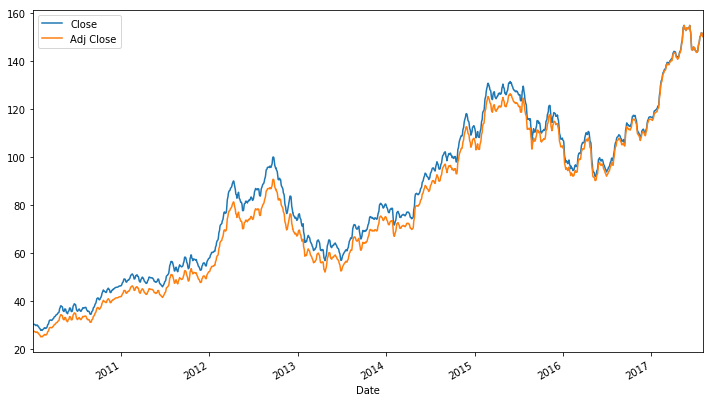

In [ ]:
aapl.rolling(5)[['Close', 'Adj Close']].mean().plot();

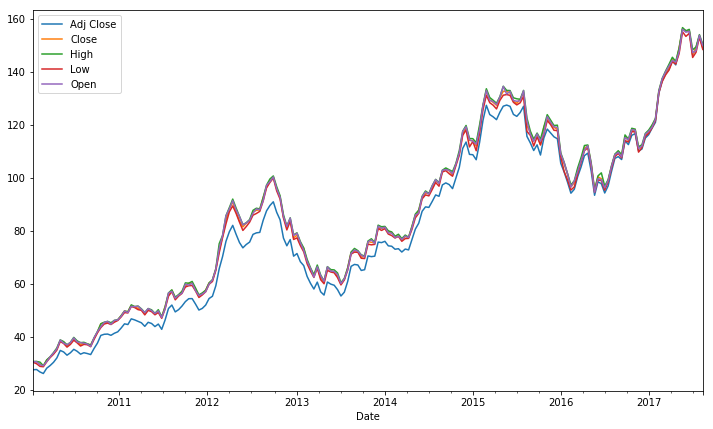

In [ ]:
# Drop `Volume`, since it's way bigger than everything else.
aapl.drop('Volume', axis=1).resample('2W').max().plot();

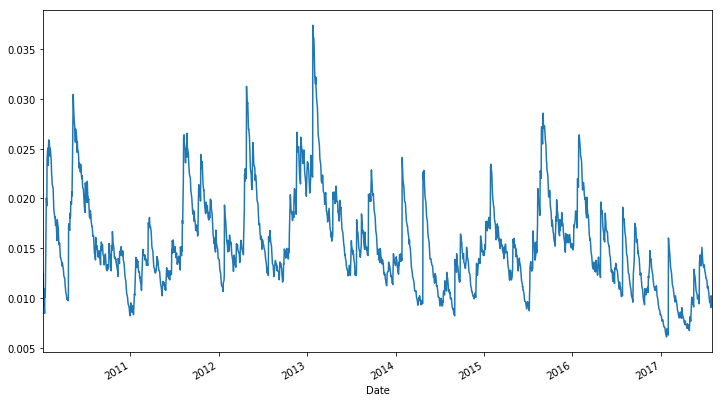

In [ ]:
# 30-day rolling exponentially-weighted stddev of returns.
aapl['Close'].pct_change().ewm(span=30).std().plot();

# "Real World" Data

In [ ]:
from demos.avocados import read_avocadata

avocados = read_avocadata('2014', '2016')
avocados.head()

,Date,Region,Variety,Organic,Number of Stores,Weighted Avg Price,Low Price,High Price
0,2014-01-03 00:00:00+00:00,NATIONAL,HASS,False,9184,0.93,NaN,NaN
1,2014-01-03 00:00:00+00:00,NATIONAL,HASS,True,872,1.44,NaN,NaN
2,2014-01-03 00:00:00+00:00,NORTHEAST,HASS,False,1449,1.08,0.5,1.67
3,2014-01-03 00:00:00+00:00,NORTHEAST,HASS,True,66,1.54,1.5,2.00
4,2014-01-03 00:00:00+00:00,SOUTHEAST,HASS,False,2286,0.98,0.5,1.99


In [ ]:
# Unlike numpy arrays, pandas DataFrames can have a different dtype for each column.
avocados.dtypes

Date                  datetime64[ns, UTC]
Region                             object
Variety                            object
Organic                              bool
Number of Stores                    int64
Weighted Avg Price                float64
Low Price                         float64
High Price                        float64
dtype: object

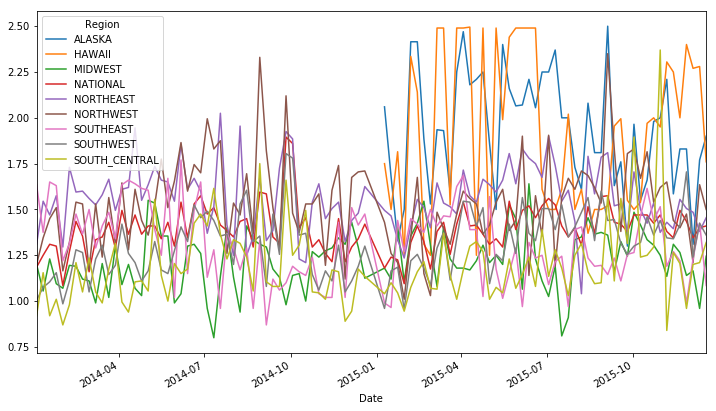

In [ ]:
# What's the regional average price of a HASS avocado every day?
hass = avocados[avocados.Variety == 'HASS']
hass.groupby(['Date', 'Region'])['Weighted Avg Price'].mean().unstack().ffill().plot();

In [ ]:
def _organic_spread(group):

    if len(group.columns) != 2:
        return pd.Series(index=group.index, data=0.0)
    
    is_organic = group.columns.get_level_values('Organic').values.astype(bool)
    organics = group.loc[:, is_organic].squeeze()
    non_organics = group.loc[:, ~is_organic].squeeze()
    diff = organics - non_organics
    return diff

def organic_spread_by_region(df):
    """What's the difference between the price of an organic 
    and non-organic avocado within each region?
    """
    return (
        df
        .set_index(['Date', 'Region', 'Organic'])
         ['Weighted Avg Price']
        .unstack(level=['Region', 'Organic'])
        .ffill()
        .groupby(level='Region', axis=1)
        .apply(_organic_spread)
    )

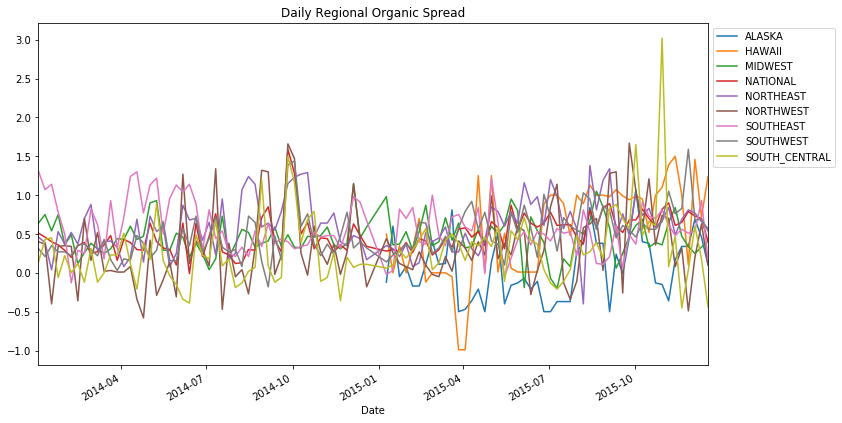

In [ ]:
organic_spread_by_region(hass).plot();
plt.gca().set_title("Daily Regional Organic Spread");
plt.legend(bbox_to_anchor=(1, 1));

In [ ]:
spread_correlation = organic_spread_by_region(hass).corr()
spread_correlation

Region,ALASKA,HAWAII,MIDWEST,NATIONAL,NORTHEAST,NORTHWEST,SOUTHEAST,SOUTHWEST,SOUTH_CENTRAL
Region,,,,,,,,,
ALASKA,1.000000,0.202723,0.175251,0.007844,0.051049,0.087575,0.129079,-0.070868,0.161624
HAWAII,0.202723,1.000000,-0.021116,0.373914,0.247171,0.341155,0.019388,0.159192,0.092632
MIDWEST,0.175251,-0.021116,1.000000,0.062595,-0.010213,-0.043783,0.047437,-0.059128,0.068902
NATIONAL,0.007844,0.373914,0.062595,1.000000,0.502035,0.579102,-0.040539,0.635006,0.486524
NORTHEAST,0.051049,0.247171,-0.010213,0.502035,1.000000,0.242039,-0.236225,0.360389,0.149881
NORTHWEST,0.087575,0.341155,-0.043783,0.579102,0.242039,1.000000,-0.032306,0.165992,0.349935
SOUTHEAST,0.129079,0.019388,0.047437,-0.040539,-0.236225,-0.032306,1.000000,-0.167631,-0.021176
SOUTHWEST,-0.070868,0.159192,-0.059128,0.635006,0.360389,0.165992,-0.167631,1.000000,0.254504
SOUTH_CENTRAL,0.161624,0.092632,0.068902,0.486524,0.149881,0.349935,-0.021176,0.254504,1.000000


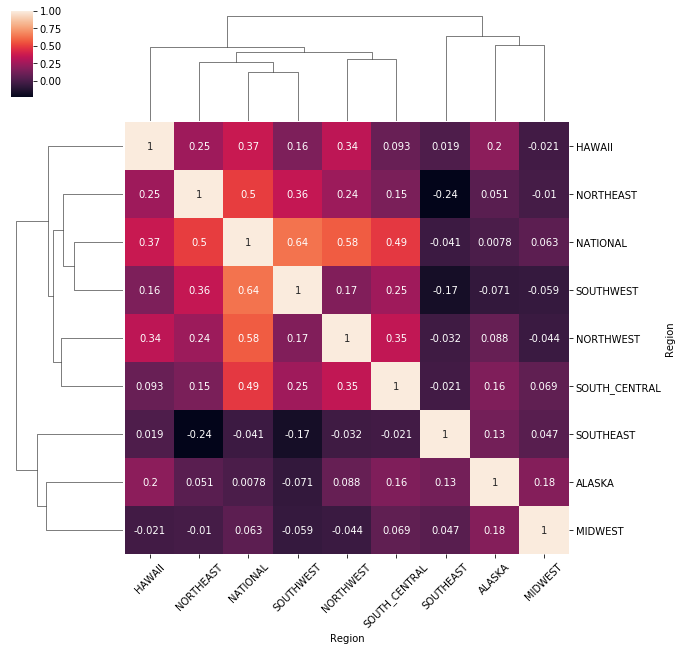

In [ ]:
import seaborn as sns
grid = sns.clustermap(spread_correlation, annot=True)
fig = grid.fig
axes = fig.axes
ax = axes[2]
ax.set_xticklabels(ax.get_xticklabels(), rotation=45);

# Pandas Review

- Pandas extends numpy with more complex datastructures and algorithms.
- If you understand numpy, you understand 90% of pandas.
- `groupby`, `set_index`, and `unstack` are powerful tools for working with categorical data.
- Avocado prices are surprisingly interesting :)

# Thanks!